# 705 CelebA GAN Project

In [1]:
import numpy as np
import random
import torch.utils.data
import torchvision.datasets as datasets
import torchvision.transforms as transforms
import torch.nn as nn
import torch.optim as optim
from torch.utils.tensorboard import SummaryWriter
from torch.utils.data import DataLoader
from utils import show_images_grid
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader


from celebAdataset import create_celebA_dataset
from dcgan import Generator, Discriminator
from training_gan import train_gan
from torchsummary import summary
from inception_score import calc_inception_score
from sagan import SAGenerator, SADiscriminator
from srgan import SRGenerator, SRDiscriminator
from main_gan import run_dcgan, run_wsgan, run_sagan



In [2]:

SEED = 42
np.random.seed(SEED)
random.seed(SEED)
torch.manual_seed(SEED)

In [3]:
device = torch.device('cpu')
if torch.cuda.is_available():
    device = torch.device('cuda:0')
print(device)

cuda:0


## celebA dataset

In [4]:
DATA_DIR='./celeba_data'
IMAGE_SIZE=64 #Should be a multiplication of 2
RUNS_DIR='./experiments'
MODELS_DIR='./saved'

In [5]:
train_celebA=create_celebA_dataset(DATA_DIR, IMAGE_SIZE, split='train')
val_celebA = create_celebA_dataset(DATA_DIR, IMAGE_SIZE, split='valid')
test_celebA = create_celebA_dataset(DATA_DIR, IMAGE_SIZE, split='test')

In [6]:
dataloader = torch.utils.data.DataLoader(train_celebA, batch_size=16
                                         ,shuffle=True)
images = next(iter(dataloader))[0]

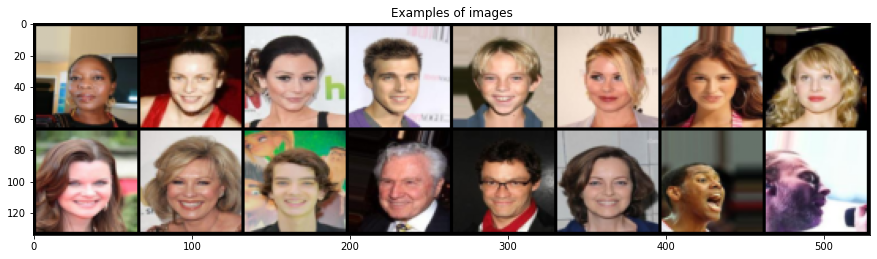

In [7]:
 _=show_images_grid(images,title=f"Examples of images", figsize=(15,10))

## DCGAN

In [8]:
BATCH_SIZE=64
NOISE_SIZE_DCGAN=100


OPTIM_DCGAN_GENERATOR={'lr':0.0002, 'betas': (0.5, 0.999)}
OPTIM_DCGAN_DISCRIMINATOR={'lr':0.0002, 'betas': (0.5, 0.999)}
OPTIM_DCGAN={'optim_gen':OPTIM_DCGAN_GENERATOR, 'optim_disc':OPTIM_DCGAN_DISCRIMINATOR}

Discriminator
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 64, 32, 32]           3,136
         LeakyReLU-2           [-1, 64, 32, 32]               0
            Conv2d-3          [-1, 128, 16, 16]         131,072
       BatchNorm2d-4          [-1, 128, 16, 16]             256
         LeakyReLU-5          [-1, 128, 16, 16]               0
            Conv2d-6            [-1, 256, 8, 8]         524,288
       BatchNorm2d-7            [-1, 256, 8, 8]             512
         LeakyReLU-8            [-1, 256, 8, 8]               0
            Conv2d-9            [-1, 512, 4, 4]       2,097,152
      BatchNorm2d-10            [-1, 512, 4, 4]           1,024
        LeakyReLU-11            [-1, 512, 4, 4]               0
           Conv2d-12              [-1, 1, 1, 1]           8,192
          Sigmoid-13              [-1, 1, 1, 1]               0
    Discriminator-14     

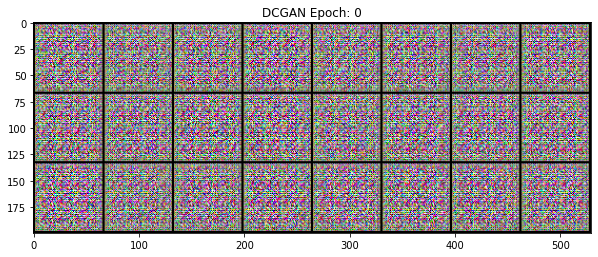

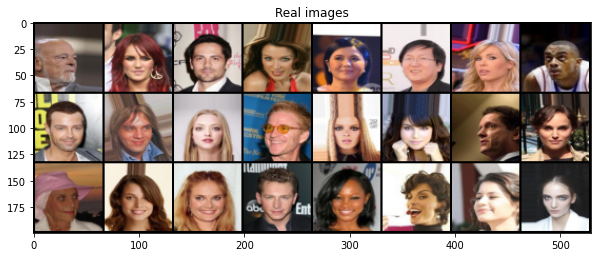

Batch:50/Epoch: 0 Generator loss: 9.152 Discriminator loss: 0.057, Acc real:93.750 Acc fake:95.312
Batch:100/Epoch: 0 Generator loss: 16.709 Discriminator loss: 0.697, Acc real:68.750 Acc fake:100.000


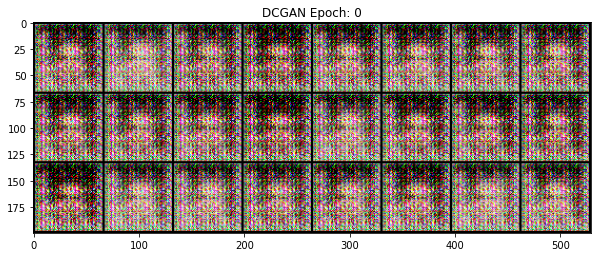

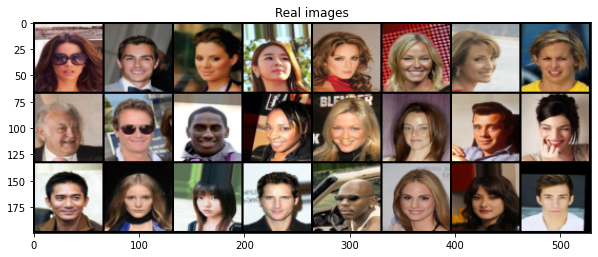

Batch:150/Epoch: 0 Generator loss: 3.359 Discriminator loss: 0.777, Acc real:90.625 Acc fake:26.562
Batch:200/Epoch: 0 Generator loss: 3.588 Discriminator loss: 1.115, Acc real:93.750 Acc fake:4.688


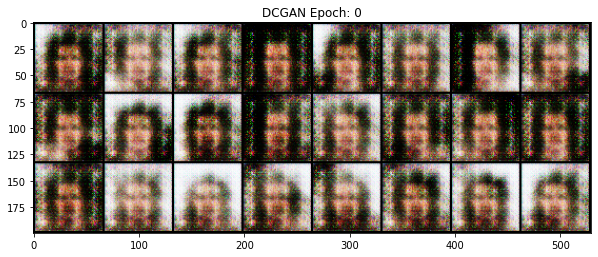

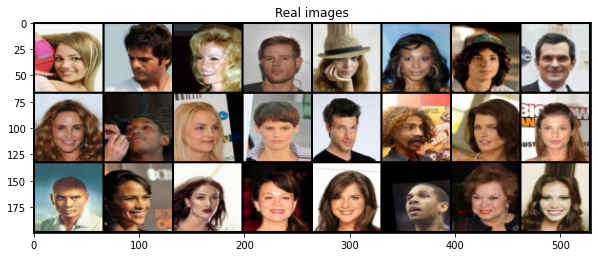

Batch:250/Epoch: 0 Generator loss: 2.604 Discriminator loss: 1.427, Acc real:96.875 Acc fake:0.000
Batch:300/Epoch: 0 Generator loss: 1.592 Discriminator loss: 0.626, Acc real:81.250 Acc fake:42.188


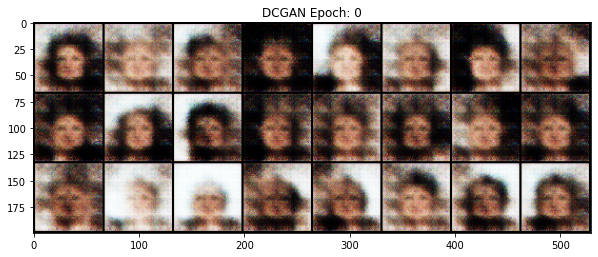

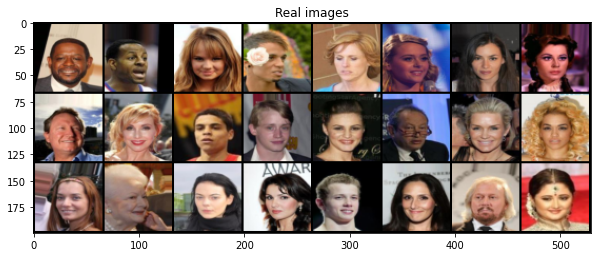

Batch:350/Epoch: 0 Generator loss: 1.276 Discriminator loss: 0.578, Acc real:42.188 Acc fake:98.438
Batch:400/Epoch: 0 Generator loss: 2.121 Discriminator loss: 0.831, Acc real:15.625 Acc fake:100.000


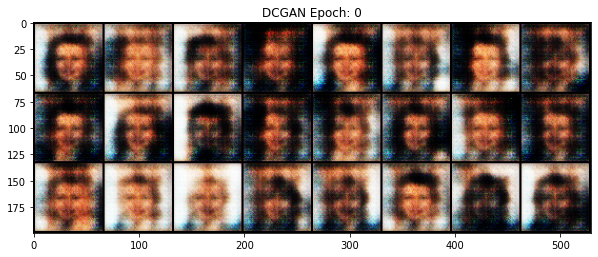

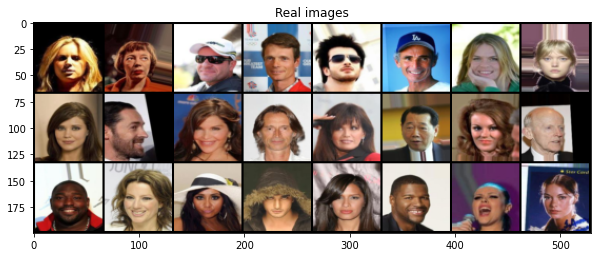

Batch:450/Epoch: 0 Generator loss: 2.991 Discriminator loss: 0.866, Acc real:95.312 Acc fake:15.625
Batch:500/Epoch: 0 Generator loss: 1.094 Discriminator loss: 0.804, Acc real:28.125 Acc fake:75.000


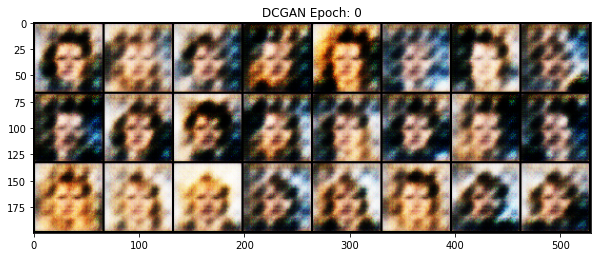

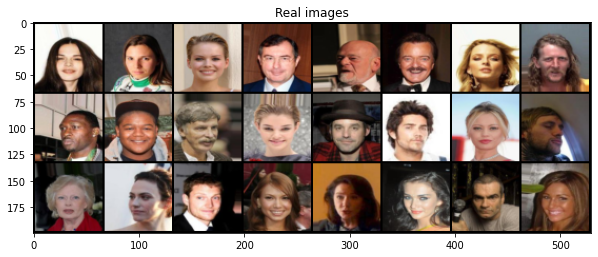

Batch:550/Epoch: 0 Generator loss: 4.400 Discriminator loss: 0.879, Acc real:100.000 Acc fake:7.812
Batch:600/Epoch: 0 Generator loss: 0.769 Discriminator loss: 0.746, Acc real:15.625 Acc fake:100.000


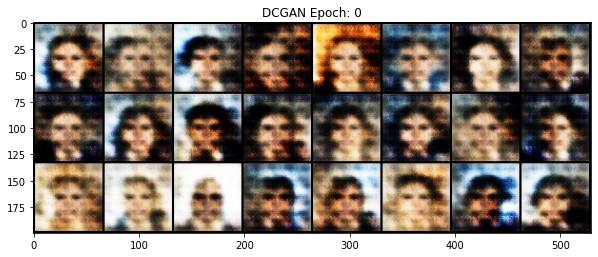

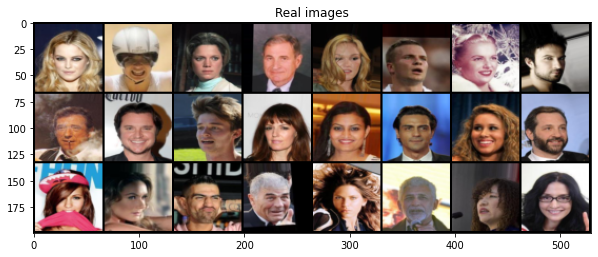

Batch:650/Epoch: 0 Generator loss: 0.850 Discriminator loss: 1.188, Acc real:1.562 Acc fake:98.438
Batch:700/Epoch: 0 Generator loss: 2.372 Discriminator loss: 0.606, Acc real:81.250 Acc fake:53.125


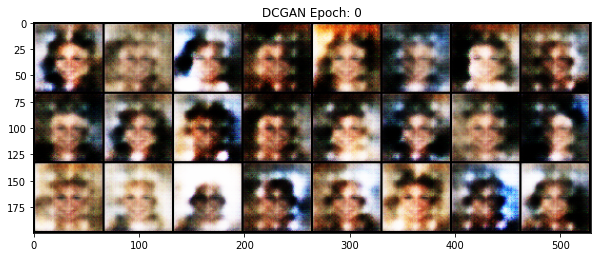

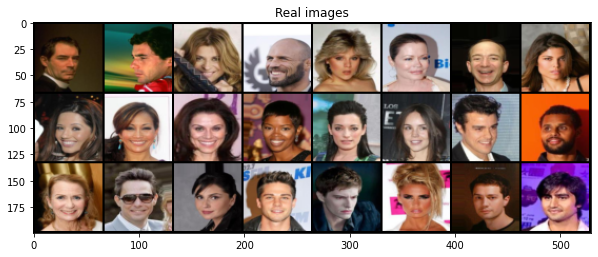

Batch:750/Epoch: 0 Generator loss: 1.596 Discriminator loss: 0.414, Acc real:81.250 Acc fake:92.188
Batch:800/Epoch: 0 Generator loss: 0.294 Discriminator loss: 1.090, Acc real:0.000 Acc fake:100.000


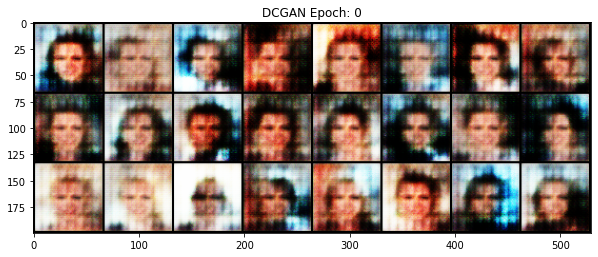

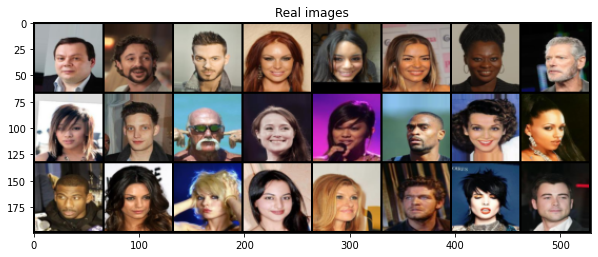

Batch:850/Epoch: 0 Generator loss: 0.766 Discriminator loss: 0.621, Acc real:37.500 Acc fake:98.438
Batch:900/Epoch: 0 Generator loss: 0.857 Discriminator loss: 0.809, Acc real:7.812 Acc fake:100.000


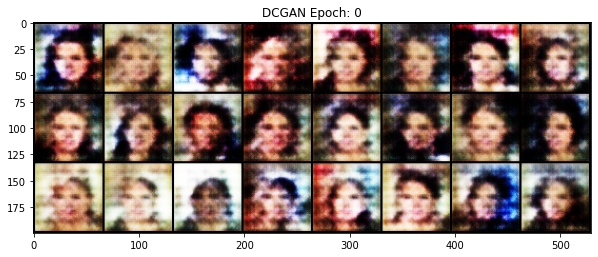

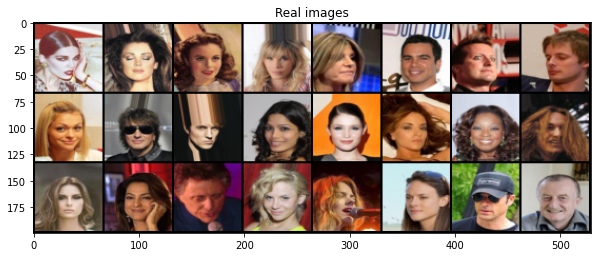

Batch:950/Epoch: 0 Generator loss: 0.607 Discriminator loss: 0.690, Acc real:37.500 Acc fake:82.812
Batch:1000/Epoch: 0 Generator loss: 2.018 Discriminator loss: 0.318, Acc real:67.188 Acc fake:100.000


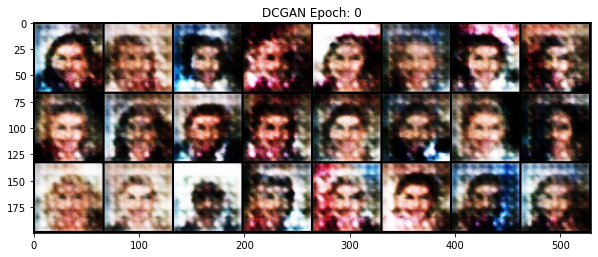

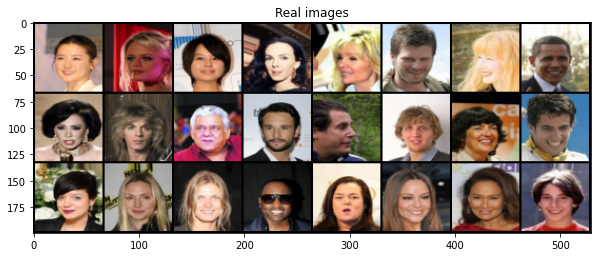

Batch:1050/Epoch: 0 Generator loss: 1.918 Discriminator loss: 0.433, Acc real:76.562 Acc fake:90.625
Batch:1100/Epoch: 0 Generator loss: 3.228 Discriminator loss: 0.826, Acc real:100.000 Acc fake:9.375


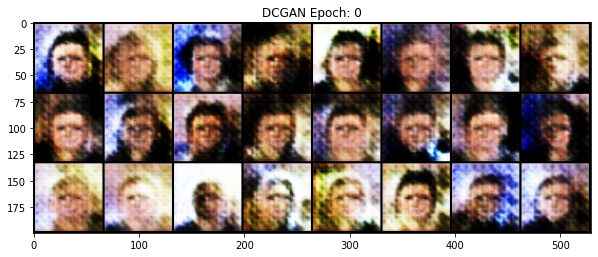

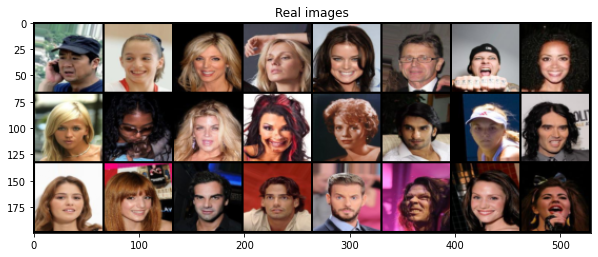

Batch:1150/Epoch: 0 Generator loss: 1.517 Discriminator loss: 0.482, Acc real:76.562 Acc fake:78.125
Batch:1200/Epoch: 0 Generator loss: 1.940 Discriminator loss: 0.448, Acc real:90.625 Acc fake:84.375


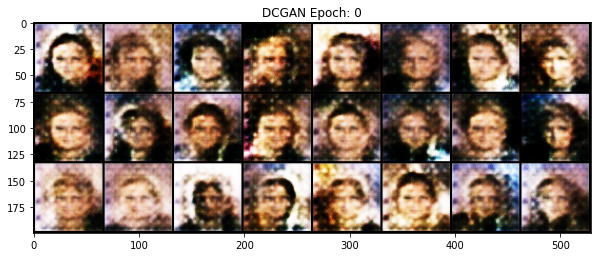

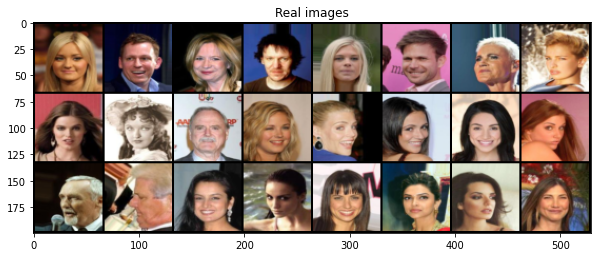

Batch:1250/Epoch: 0 Generator loss: 2.274 Discriminator loss: 0.520, Acc real:23.438 Acc fake:100.000
Batch:1300/Epoch: 0 Generator loss: 0.324 Discriminator loss: 0.971, Acc real:4.688 Acc fake:100.000


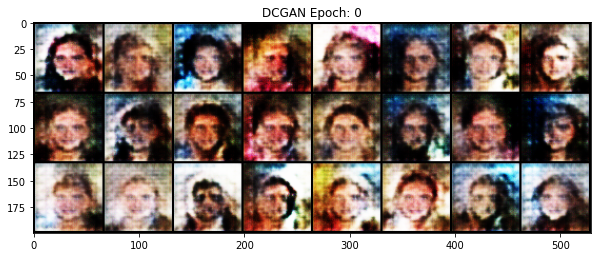

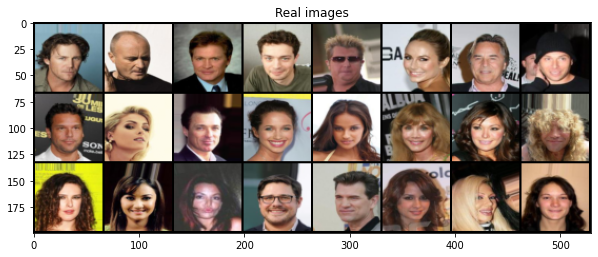

Batch:1350/Epoch: 0 Generator loss: 1.937 Discriminator loss: 0.420, Acc real:79.688 Acc fake:93.750
Batch:1400/Epoch: 0 Generator loss: 1.474 Discriminator loss: 0.371, Acc real:65.625 Acc fake:100.000


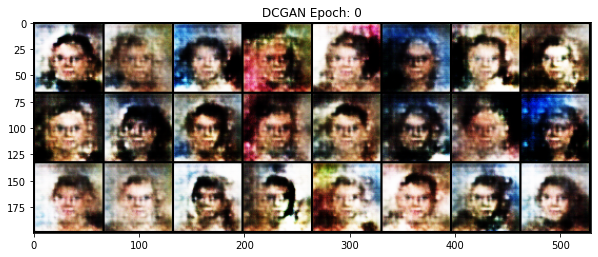

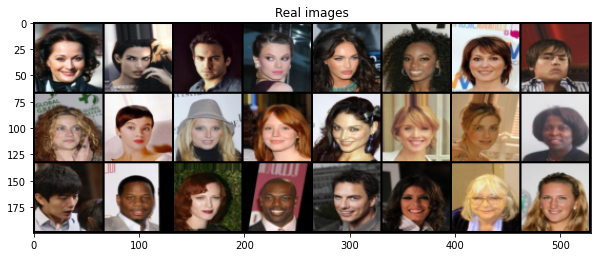

Batch:1450/Epoch: 0 Generator loss: 1.524 Discriminator loss: 0.490, Acc real:85.938 Acc fake:67.188
Batch:1500/Epoch: 0 Generator loss: 1.008 Discriminator loss: 0.765, Acc real:17.188 Acc fake:100.000


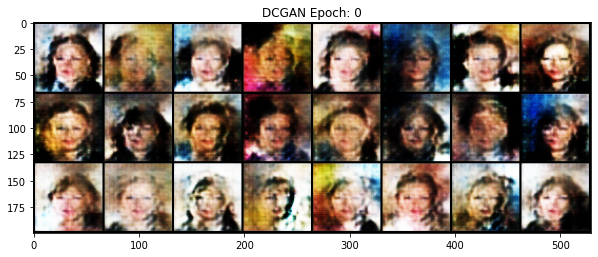

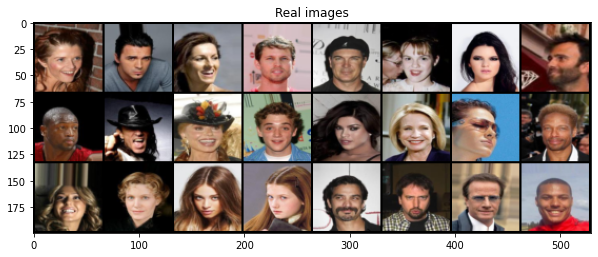

Batch:1550/Epoch: 0 Generator loss: 2.436 Discriminator loss: 0.704, Acc real:93.750 Acc fake:23.438
Batch:1600/Epoch: 0 Generator loss: 2.416 Discriminator loss: 0.734, Acc real:98.438 Acc fake:9.375


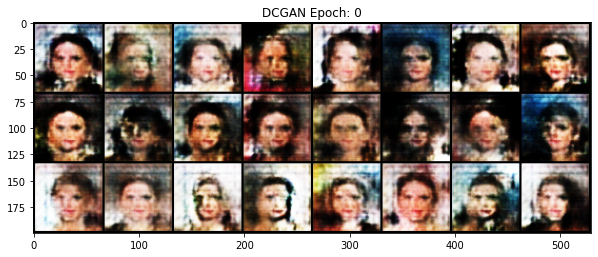

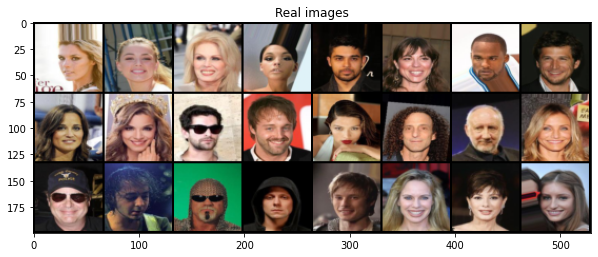

Batch:1650/Epoch: 0 Generator loss: 1.522 Discriminator loss: 0.524, Acc real:26.562 Acc fake:100.000
Batch:1700/Epoch: 0 Generator loss: 1.263 Discriminator loss: 0.588, Acc real:51.562 Acc fake:92.188


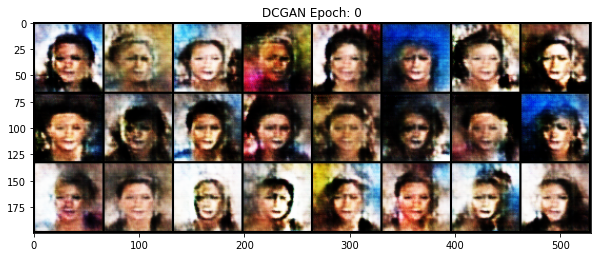

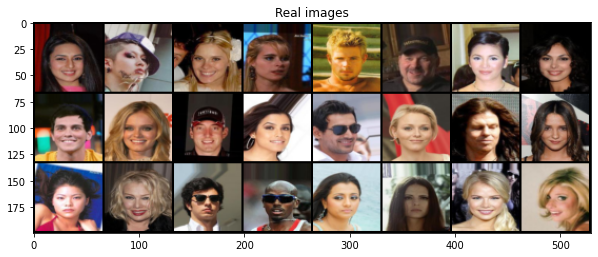

Batch:1750/Epoch: 0 Generator loss: 1.506 Discriminator loss: 0.450, Acc real:92.188 Acc fake:64.062
Batch:1800/Epoch: 0 Generator loss: 3.032 Discriminator loss: 0.511, Acc real:89.062 Acc fake:68.750


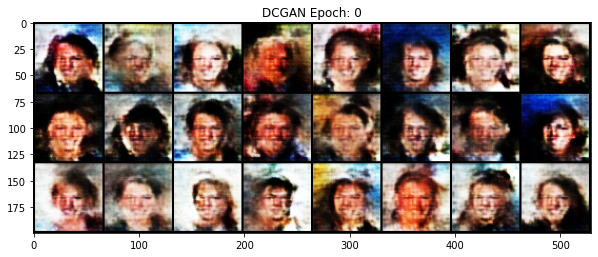

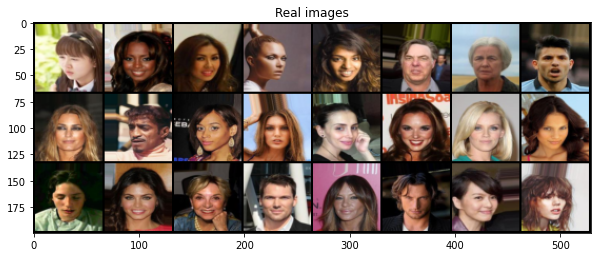

Batch:1850/Epoch: 0 Generator loss: 1.825 Discriminator loss: 0.371, Acc real:92.188 Acc fake:90.625
Batch:1900/Epoch: 0 Generator loss: 1.134 Discriminator loss: 0.575, Acc real:35.938 Acc fake:98.438


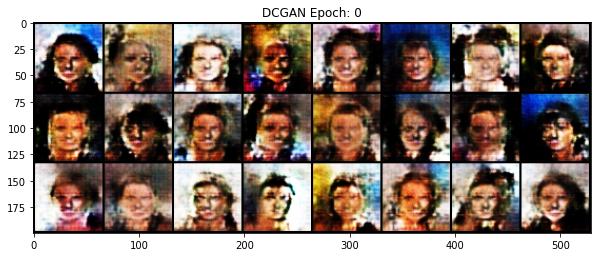

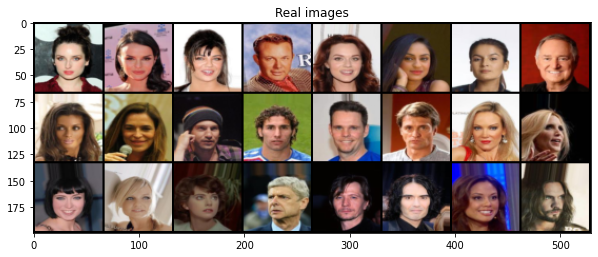

Batch:1950/Epoch: 0 Generator loss: 1.475 Discriminator loss: 0.561, Acc real:43.750 Acc fake:92.188
Batch:2000/Epoch: 0 Generator loss: 3.140 Discriminator loss: 0.910, Acc real:100.000 Acc fake:1.562


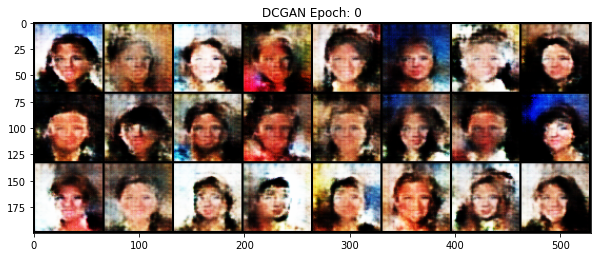

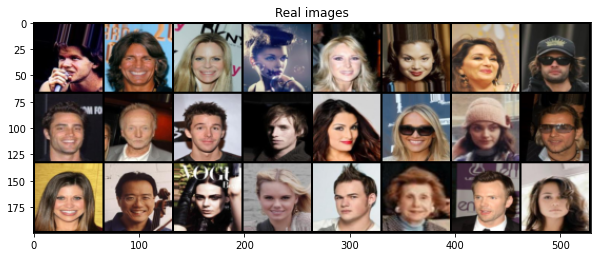

Batch:2050/Epoch: 0 Generator loss: 0.860 Discriminator loss: 0.526, Acc real:34.375 Acc fake:100.000
Batch:2100/Epoch: 0 Generator loss: 1.445 Discriminator loss: 0.256, Acc real:96.875 Acc fake:100.000


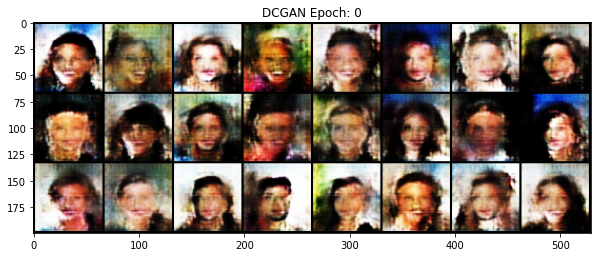

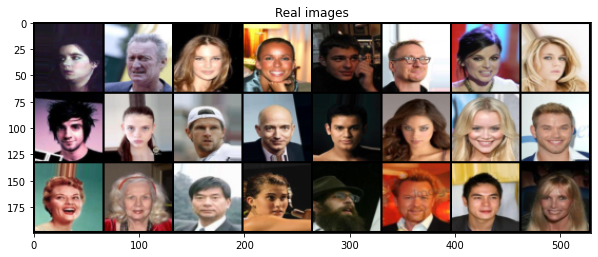

Batch:2150/Epoch: 0 Generator loss: 1.783 Discriminator loss: 0.475, Acc real:57.812 Acc fake:100.000
Batch:2200/Epoch: 0 Generator loss: 5.505 Discriminator loss: 0.913, Acc real:100.000 Acc fake:0.000


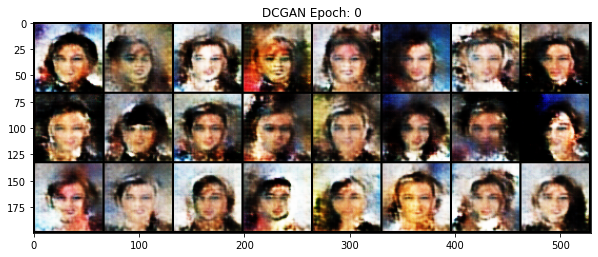

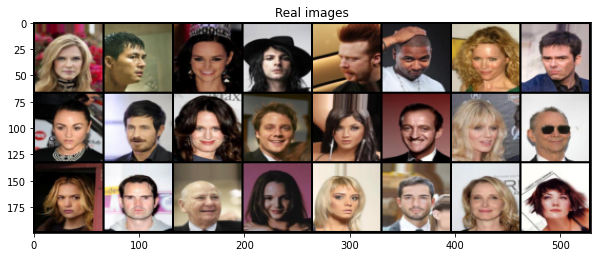

Batch:2250/Epoch: 0 Generator loss: 0.918 Discriminator loss: 0.409, Acc real:60.938 Acc fake:100.000
Batch:2300/Epoch: 0 Generator loss: 1.295 Discriminator loss: 0.572, Acc real:65.625 Acc fake:81.250


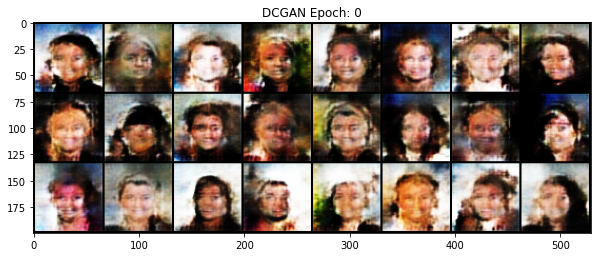

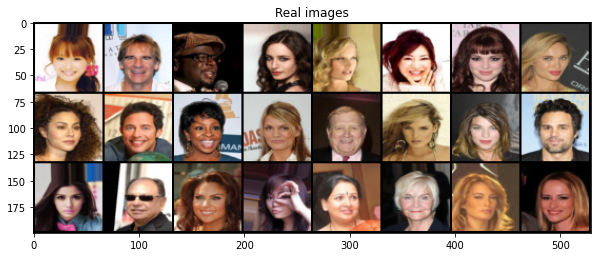

Batch:2350/Epoch: 0 Generator loss: 1.729 Discriminator loss: 0.367, Acc real:70.312 Acc fake:98.438
Batch:2400/Epoch: 0 Generator loss: 2.082 Discriminator loss: 0.638, Acc real:82.812 Acc fake:37.500


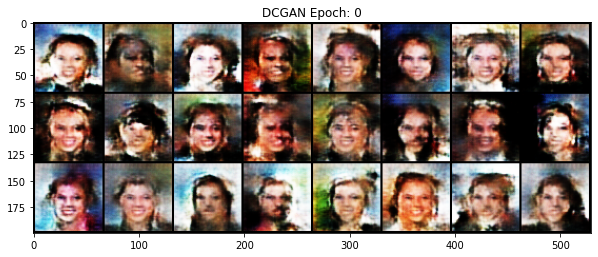

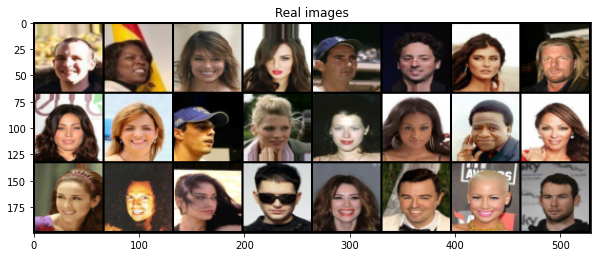

Batch:2450/Epoch: 0 Generator loss: 3.142 Discriminator loss: 0.323, Acc real:96.875 Acc fake:87.500
Batch:2500/Epoch: 0 Generator loss: 2.293 Discriminator loss: 0.284, Acc real:96.875 Acc fake:93.750


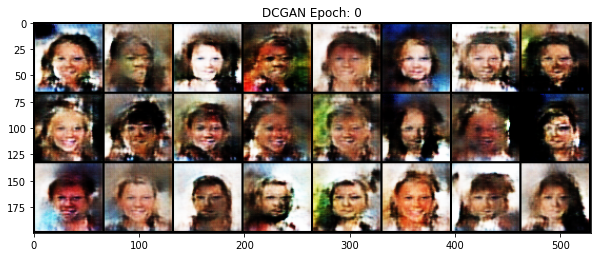

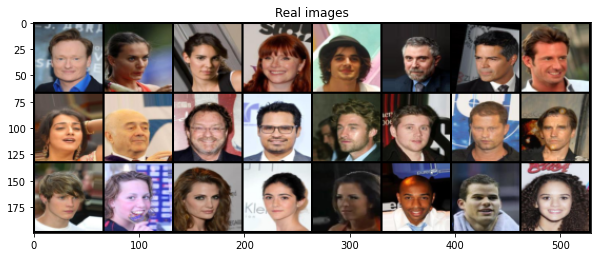

Epoch:0 FID score:167.419  Inception score:2.986 


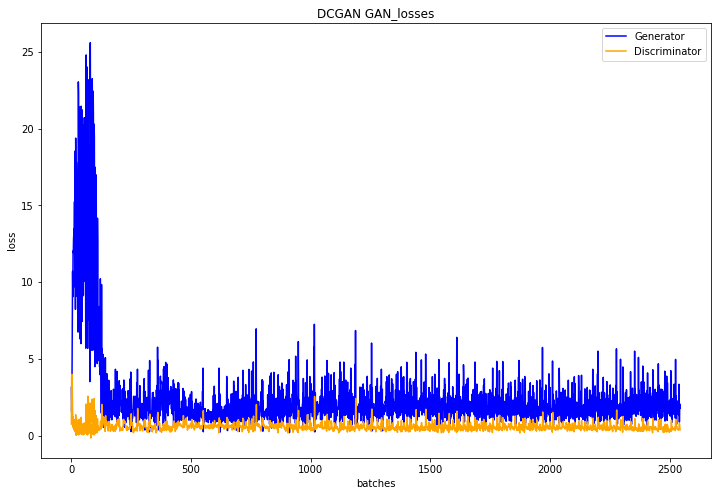

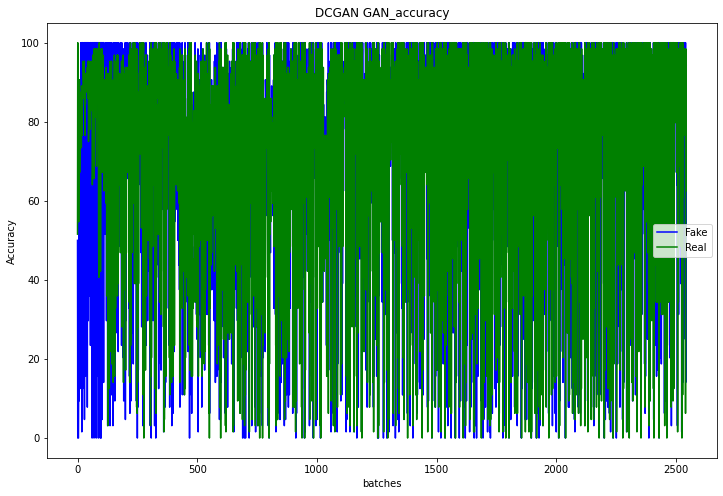

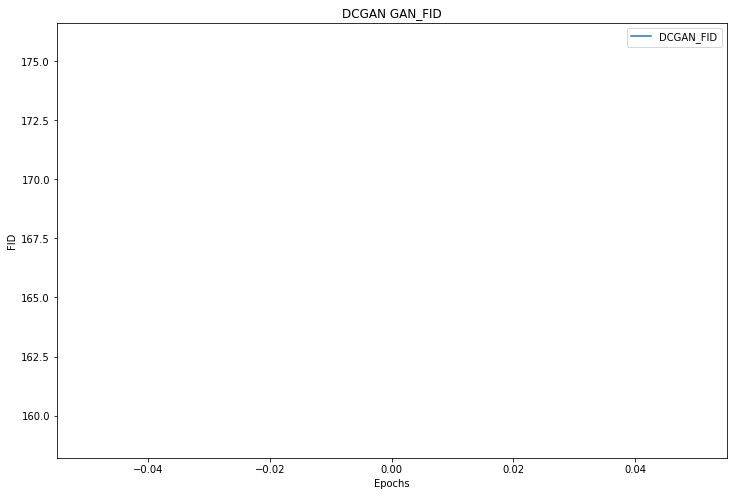

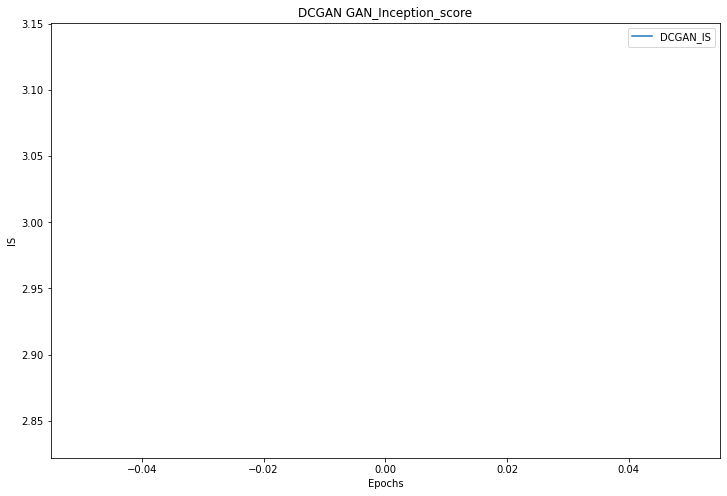

In [18]:
inception_FID_scores, inception_scores=run_dcgan(device, IMAGE_SIZE, NOISE_SIZE_DCGAN, BATCH_SIZE, OPTIM_DCGAN, RUNS_DIR, MODELS_DIR,
              'dcgan', 1, val_celebA , train_dataset=train_celebA, checkpoints=None, mode='train')

## Wasserstein GAN (WGAN-GP)

In [9]:
OPTIM_WSGAN_GENERATOR={'lr':1e-4, 'betas': (0.0, 0.9)}
OPTIM_WSGAN_DISCRIMINATOR={'lr':1e-4, 'betas': (0.0, 0.9)}
OPTIM_WSGAN={'optim_gen':OPTIM_WSGAN_GENERATOR, 'optim_disc':OPTIM_WSGAN_DISCRIMINATOR}

LAMBDA_PENALTY = 10

NOISE_SIZE_WS_GAN=64

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 64, 32, 32]           3,136
         LeakyReLU-2           [-1, 64, 32, 32]               0
            Conv2d-3          [-1, 128, 16, 16]         131,072
    InstanceNorm2d-4          [-1, 128, 16, 16]               0
         LeakyReLU-5          [-1, 128, 16, 16]               0
            Conv2d-6            [-1, 256, 8, 8]         524,288
    InstanceNorm2d-7            [-1, 256, 8, 8]               0
         LeakyReLU-8            [-1, 256, 8, 8]               0
            Conv2d-9            [-1, 512, 4, 4]       2,097,152
   InstanceNorm2d-10            [-1, 512, 4, 4]               0
        LeakyReLU-11            [-1, 512, 4, 4]               0
           Conv2d-12           [-1, 64, 32, 32]           3,136
           Conv2d-13              [-1, 1, 1, 1]           8,192
    Discriminator-14              [-1, 

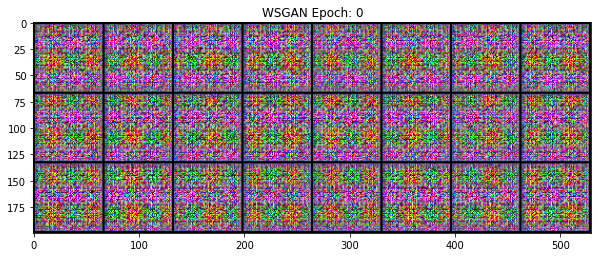

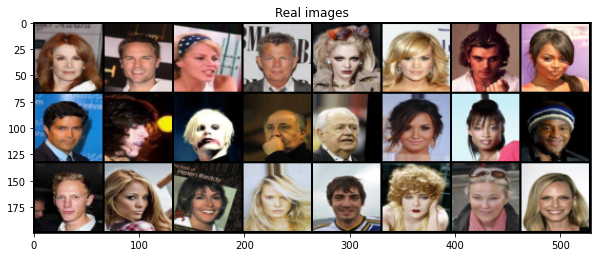

Batch50/Epoch: 0 Critic: 44.343 Generator loss: 44.868 
Batch100/Epoch: 0 Critic: 38.815 Generator loss: 42.170 


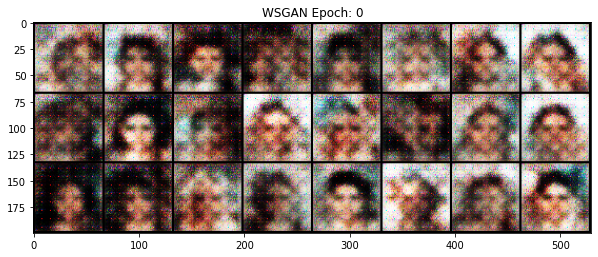

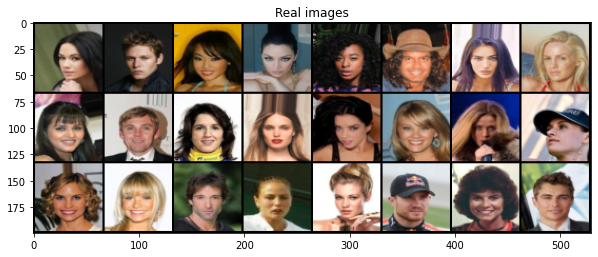

Batch150/Epoch: 0 Critic: 16.629 Generator loss: 36.342 
Batch200/Epoch: 0 Critic: 13.097 Generator loss: 17.375 


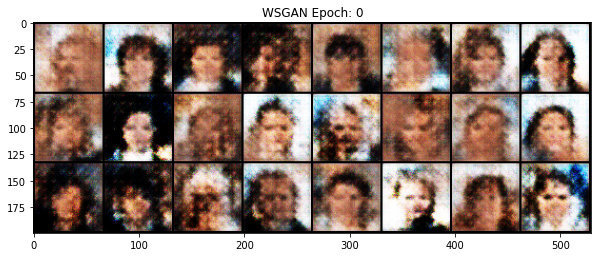

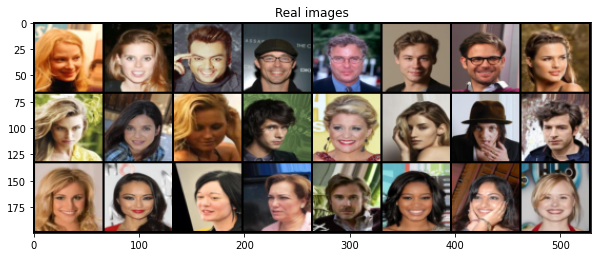

Batch250/Epoch: 0 Critic: 11.999 Generator loss: 12.754 
Batch300/Epoch: 0 Critic: 12.493 Generator loss: 23.787 


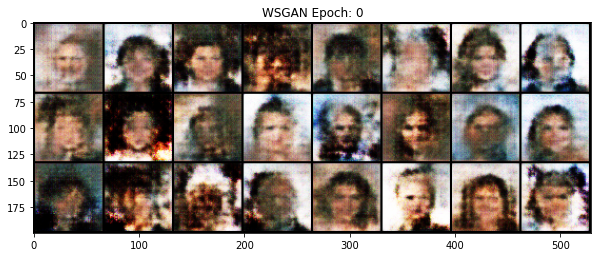

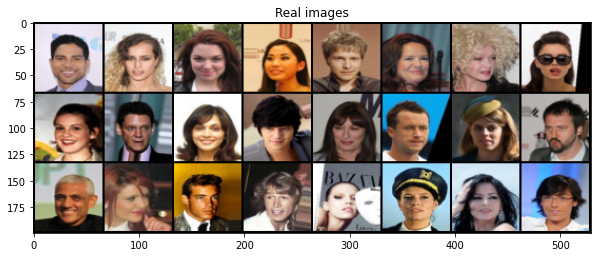

Batch350/Epoch: 0 Critic: 8.696 Generator loss: 24.300 
Batch400/Epoch: 0 Critic: 10.367 Generator loss: 29.156 


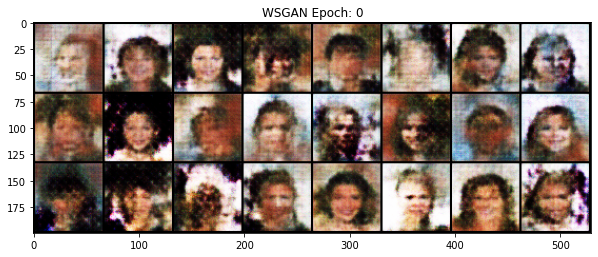

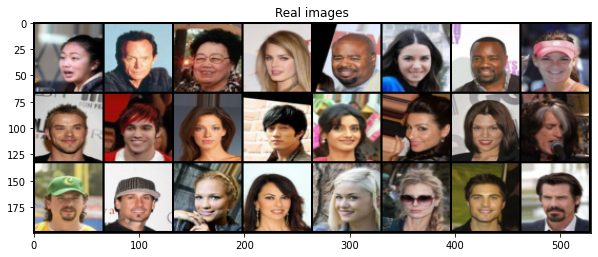

Batch450/Epoch: 0 Critic: 8.241 Generator loss: 30.274 
Batch500/Epoch: 0 Critic: 8.490 Generator loss: 21.600 


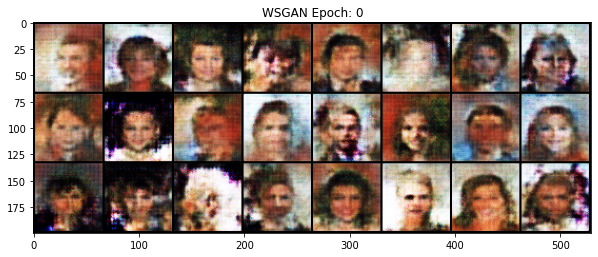

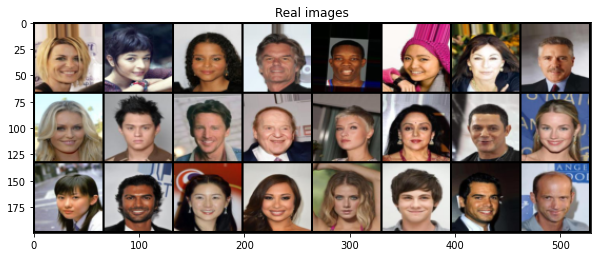

Batch550/Epoch: 0 Critic: 8.772 Generator loss: 49.040 
Batch600/Epoch: 0 Critic: 9.346 Generator loss: 28.167 


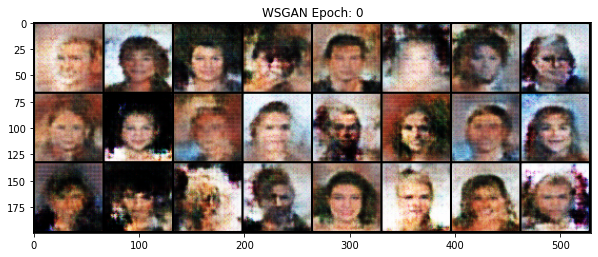

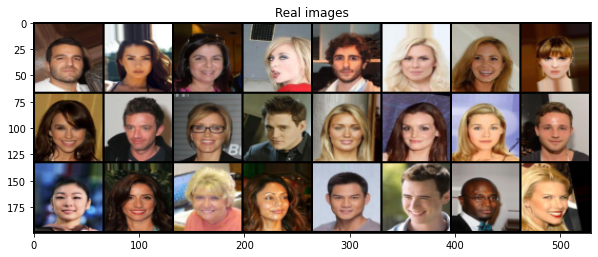

In [ ]:
inception_FID_scores, inception_scores=run_wsgan(device, IMAGE_SIZE, NOISE_SIZE_WS_GAN, BATCH_SIZE, OPTIM_WSGAN, RUNS_DIR, MODELS_DIR,
                'wsgan',1, val_celebA, train_dataset=train_celebA, checkpoints=None, mode='train', gpu_num=2)

## Self Attention GAN (SAGAN)

In [ ]:
SA_IMAGE_SIZE=64

NOISE_SIZE_SA_GAN=100
OPTIM_SRGAN_GENERATOR={'lr':1e-4}
OPTIM_SRGAN_DISCRIMINATOR={'lr':4e-4}
OPTIM_SAGAN={'optim_gen':OPTIM_SRGAN_GENERATOR, 'optim_disc':OPTIM_SRGAN_DISCRIMINATOR}

In [ ]:
inception_FID_scores, inception_scores=run_sagan(device, SA_IMAGE_SIZE, NOISE_SIZE_SA_GAN, BATCH_SIZE, OPTIM_SAGAN, RUNS_DIR, MODELS_DIR,
'sagan', 1, val_celebA, train_dataset=train_celebA, checkpoints=None, mode='train')